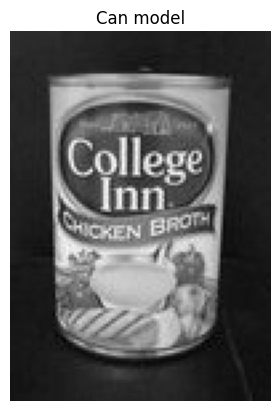

In [1]:
import os
import re
import numpy as np
from skimage import io
from skimage import color
from skimage import filters
from skimage import feature
from scipy.ndimage import maximum_filter
import cv2
from matplotlib import pyplot as plt
from scipy.spatial.distance import cdist
import pandas as pd
from typing import Callable

plt.axis("off")
canModel = io.imread("../imgs/can/can_model.jpg")
canModel = color.rgb2gray(canModel)
plt.title("Can model")
plt.imshow(canModel, cmap="gray")


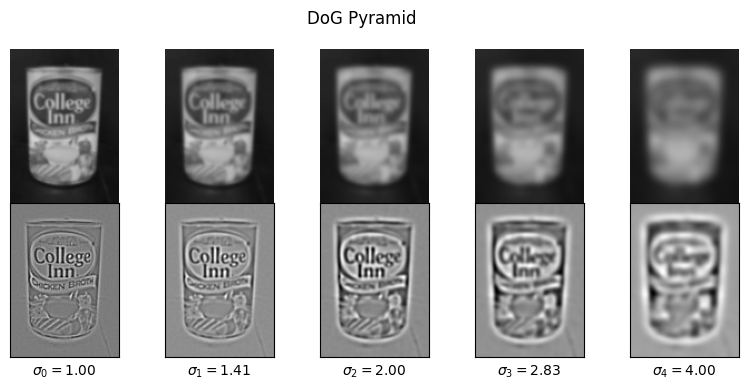

In [2]:
def createPyramid(
    img: np.ndarray, sigma0: float, k: float, numLevels: int
) -> tuple[np.ndarray, list]:
    """
    Creates Gaussian pyramid and DoG pyramid.

    Parameters
    ----------
    img : np.ndarray
        Input image.
    sigma0 : float
        Gaussian filter variance for the first level.
    k : float
        Multiplicative increase in filter size for next pyramid level.
    numLevels : int
        Number of levels for the pyramid.

    Returns
    -------
    tuple[np.ndarray, list]
        Gaussian pyramid and DoG pyramid.

    Raises
    ------
    TypeError
        Raised if img is np.floating type
    ValueError
        Raised if img is not normalized in range (0,1).
    """

    if not np.issubdtype(img.dtype, np.floating):
        raise TypeError(f"Expected float type got {img.dtype}")
    if img.min() < 0 or img.max() > 1:
        raise ValueError(
            f"Expected min and max value between 0 and 1 got {img.min(),img.max()}"
        )
    GaussianPyramid = []
    for i in range(-1, numLevels):
        GaussianPyramid.append(
            filters.gaussian(img, sigma=k**i * sigma0, mode="reflect")
        )
    DoGPyramid = list(np.diff(GaussianPyramid, n=1, axis=0))
    return GaussianPyramid[1:], DoGPyramid


sigma0 = 1
k = np.sqrt(2)
numLevels = 5
GaussianPyramid, DoGPyramid = createPyramid(canModel, sigma0, k, numLevels)
n = len(GaussianPyramid)
fig, axes = plt.subplots(2, n, figsize=(10, 4))

fig.subplots_adjust(wspace=0, hspace=0)
fig.suptitle("DoG Pyramid")
for i, (axUp, axDown) in enumerate(zip(*axes)):
    axUp.imshow(GaussianPyramid[i], cmap="gray", vmin=0, vmax=1)
    axUp.set_axis_off()
    axUp.set_aspect("equal")

    axDown.imshow(DoGPyramid[i], cmap="gray")
    axDown.set_xticks([])
    axDown.set_yticks([])
    axDown.tick_params(axis="both", which="both", length=0)
    axDown.grid(False)
    axDown.set_aspect("equal")
    axDown.set_xlabel(rf"$\sigma_{i} = {k**i * sigma0:.2f}$")


## Zadatak 1
1)U ovom delu potrebno je izračunati Gausovu piramidu sa <code> numLevels</code> nivoa.
<br><br/>
Najpre je potrebno isflitrirati sliku sa različitim standardnim devijacijama Gausovog filtra počevši od $\sigma_{0}=1$ (prvi red slika), zatim se računa razlika između dva susedna nivoa kako bismo dobili Difference of Gaussians (DoG, drugi red slika). Kao što se može očekivati sa povećanjem standardne devijacije slika je zamućenija.


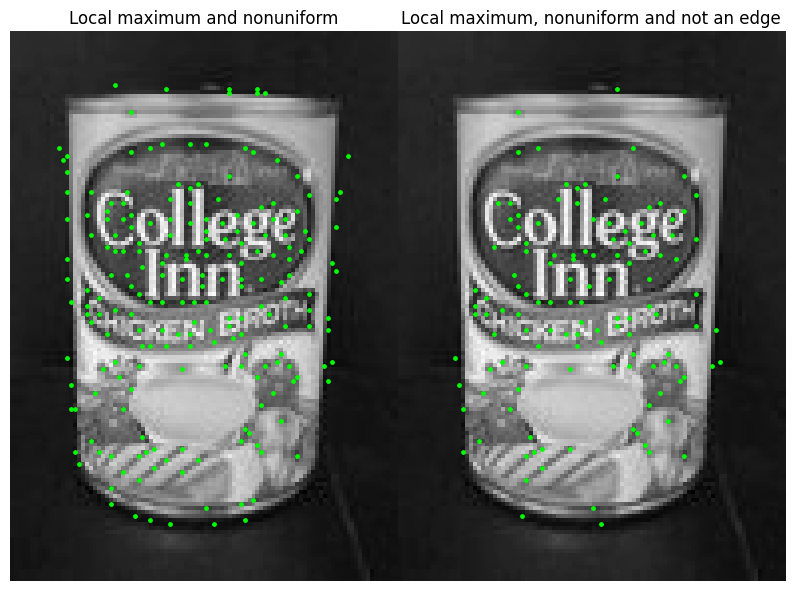

In [3]:
def detectDoGFeatures(DoGPyramid: list, uniformTh: float, edgeThr: float) -> list:
    """
    Detects key feature points in DoGPyramid.

    Parameters
    ----------
    DoGPyramid : list
        List of different levels of DoG.
    uniformTh : float
        Threshold for uniform background points.
    edgeThr : float
        Threshold for Hessian based edge points.

    Returns
    -------
    list
        List of features (x, y, scale).
    """
    DoGPyramid = np.array(DoGPyramid)
    # Local maximum peaks
    localPeaks = (
        maximum_filter(DoGPyramid, footprint=np.ones((3, 3, 3)), mode="nearest")
        == DoGPyramid
    )
    notUniform = np.abs(DoGPyramid) > uniformTh
    candidates = np.logical_and(localPeaks, notUniform)
    featureLocations = []
    for scale, y, x in zip(*np.nonzero(candidates)):
        if (
            x < 2
            or x > DoGPyramid.shape[2] - 3
            or y < 2
            or y > DoGPyramid.shape[1] - 3
        ):
            continue
        localNeighborhood = DoGPyramid[scale, y - 2 : y + 3, x - 2 : x + 3]
        # First derivative
        Dx = (localNeighborhood[1:-1, 2:] - localNeighborhood[1:-1, :-2]) / 2
        Dy = (localNeighborhood[2:, 1:-1] - localNeighborhood[:-2, 1:-1]) / 2
        # Second derivative
        Dxx = (Dx[1, 2] - Dx[1, 0]) / 2
        Dyx = (Dx[2, 1] - Dx[0, 1]) / 2
        Dyy = (Dy[2, 1] - Dy[0, 1]) / 2
        Dxy = (Dy[1, 2] - Dy[1, 0]) / 2
        detH = Dxx * Dyy - Dxy * Dyx
        traceH = Dxx + Dyy
        ratio = traceH * traceH / detH
        if ratio < edgeThr:
            featureLocations.append((x, y, scale))
    return featureLocations


uniformTh = 0.03
edgeThr = 12
localPeaks = (
    maximum_filter(
        np.array(DoGPyramid), footprint=np.ones((3, 3, 3)), mode="nearest"
    )
    == DoGPyramid
)
notUniform = np.abs(DoGPyramid) > uniformTh
candidates = np.logical_and(localPeaks, notUniform)
candidates = np.transpose(np.transpose(candidates).nonzero())
featureLocations = detectDoGFeatures(DoGPyramid, uniformTh, edgeThr)
fig, (axLeft, axRight) = plt.subplots(1, 2, figsize=(10, 14))
fig.subplots_adjust(wspace=0, hspace=0)

axLeft.imshow(canModel, cmap="gray")
axLeft.scatter(
    np.array(candidates)[:, 0], np.array(candidates)[:, 1], c="lime", s=6
)
axLeft.set_axis_off()
axLeft.set_aspect("equal")
axLeft.set_title("Local maximum and nonuniform")
axRight.imshow(canModel, cmap="gray")
axRight.scatter(
    np.array(featureLocations)[:, 0],
    np.array(featureLocations)[:, 1],
    c="lime",
    s=6,
)
axRight.set_axis_off()
axRight.set_aspect("equal")
axRight.set_title("Local maximum, nonuniform and not an edge")


## Zadatak 1
2)Da bismo dobili karakteristične tačke u DoG piramidi, potrebno je naći lokalne maksimume kao početne kandidate. Ovo je dobijeno tako što se odradi maks filter (računa se maksimalna vrednost u lokalnom susedsvu 3x3x3 za svaki piksel u piramidi) i smatra se da je lokalni maksimum tamo gde vrednost ostaje ista pre i posle max filtera.
<br><br/>
Zatim se odbacuju kanditati sa malom apsolutnom vrednošću DoG piramide (leva slika). Može se videti da postoji dosta tačaka na obodu konzerve (delovi ivica).
<br><br/>
Poslednji korak ovde je da se suzbiju tačke na ivicama. Za svaki trenutni kandidat gleda se loklano susedstvo 5x5 da bi se izračunao prvi izvod po x i y dimenzije 3x3, zatim se za svakog kandidata može dobiti jedistvena vrednost drugog izvoda ponavljanjem istog operatora za izvod ($f'(x)= \frac{f(x+1) - f(x-1)}{2} $).
<br><br/>
Kriterijumska funkcija se računa kao odnos kvadrata traga Hesijana i determinante Hesijana $ \frac {trace{H}^2}{\det{H}}$, gde se determinanta računa kao $\det{H} = D_{xx}D_{yy}-D_{xy}D_{yx}$, a trag $trace{H}= D_{xx} + D_{yy}$.
 Gledajući desnu sliku može se primetiti da je veći deo ivičnih tačaka suzbijen.

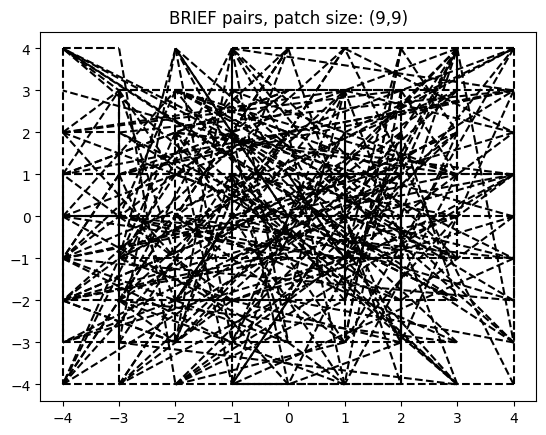

In [4]:
def generateBRIEFpattern(
    patchSize: int, testNum: int
) -> tuple[np.ndarray, np.ndarray]:
    """
    Generates BRIEF pattern size patchSize for testNum of pair of points.

    Parameters
    ----------
    patchSize : int
        Size of local region.
    testNum : int
        Number of pair points.

    Returns
    -------
    tuple[np.ndarray, np.ndarray]
        Tuple of first and second points, length testNum.
    """
    np.random.seed(1)
    p1Coords = np.random.rand(testNum, 2) * patchSize - (patchSize // 2)
    p1Coords = np.floor(p1Coords).astype(np.intp)
    np.random.seed(2)
    p2Coords = np.random.rand(testNum, 2) * patchSize - (patchSize // 2)
    p2Coords = np.floor(p2Coords).astype(np.intp)
    return p1Coords, p2Coords


patchSize = 9
testNum = 256
p1Coords, p2Coords = generateBRIEFpattern(patchSize, testNum)
for p1, p2 in zip(p1Coords, p2Coords):
    plt.plot(*zip(p1, p2), "--", c="k")
plt.title(f"BRIEF pairs, patch size: ({patchSize},{patchSize})")


## Zadatak 2
1)Za generisanje BRIEF parova tačaka korišćen je random generator brojeva sa unfirmnom raspodelom koji je inicijalizovan sa različitim seed-om za prve i druge tačke svih parova. <br/>
Može se primetiti da je raspon lokalnog regiona <code>(-patchSize//2,patchSize//2)</code> za neparan <code>patchSize</code> i <code>(-patchSize//2,patchSize//2-1)</code> za paran <code>patchSize</code>.

In [5]:
def computePyrBRIEF(
    GaussianPyramid: np.ndarray,
    featureLocations: list,
    k: float,
    patchSize: int,
    p1Coords: np.ndarray,
    p2Coords: np.ndarray,
) -> tuple[np.ndarray, np.ndarray]:
    """
    Computes descriptions of featureLocations that are not outside of image boundary.

    Parameters
    ----------
    GaussianPyramid : np.ndarray
        Gaussian pyramid.
    featureLocations : list
        Position of located key features.
    k : float
        Multiplicative increase in scale for next pyramid level.
    patchSize : int
        Local Region used for p1Coords and p2Coords.
    p1Coords : np.ndarray
        First point in BRIEF pair.
    p2Coords : np.ndarray
        Second point in BRIEF pair.

    Returns
    -------
    tuple[np.ndarray,np.ndarray]
        Description of key feature and there respective location.

    Raises
    ------
    ValueError
        If p1Coords and p2Coords length dont match.
    """

    if len(p1Coords) != len(p2Coords):
        raise ValueError("Coordinates length dont match!")
    descBRIEF = []
    locBRIEF = []
    imgHeight, imgWidth = GaussianPyramid[0].shape
    for x, y, scale in featureLocations:
        # Rescaled patchSize
        regionSize = patchSize * k**scale
        borderWidth = regionSize // 2
        # Outside of image boundary for x,y
        if (
            x < borderWidth
            or x > imgWidth - (borderWidth + 1)
            or y < borderWidth
            or y > imgHeight - (borderWidth + 1)
        ):
            continue
        p1RelativeCords = (
            np.round(p1Coords / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        p2RelativeCords = (
            np.round(p2Coords / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        img = GaussianPyramid[scale]
        p1 = img[p1RelativeCords[1], p1RelativeCords[0]]
        p2 = img[p2RelativeCords[1], p2RelativeCords[0]]
        # BRIEF descriptor
        descBRIEF.append(p1 > p2)
        locBRIEF.append((x, y, scale))
    descBRIEF = np.array(descBRIEF).T
    locBRIEF = np.array(locBRIEF).T
    return descBRIEF, locBRIEF


descBRIEFCan1, locBRIEFCan1 = computePyrBRIEF(
    GaussianPyramid, featureLocations, k, patchSize, p1Coords, p2Coords
)

print(
    "BRIEF descriptor example:",
    "".join(["1" if bit else "0" for bit in descBRIEFCan1[0]]),
)


BRIEF descriptor example: 1111001111110101000000001000001111111111110010001100100010111001110000001011011011101110100011011000010011110100010010101111


## Zadatak 2
2)U ovom delu potrebno je iskoristiti lokacije tačaka koje predstavljaju obeležja i BRIF kooridinate na Gausovoj piramidi. Najpre se izabere odgovarajući nivo piramide (informacija se nalazi u <code> featureLocations</code>), zatim se BRIEF koordiante preskaliraju za taj odgovarajući nivo formulom <code> patchSize * k**scale </code>. Na kraju je potrebno indeksirati vrednosti iz Gausove piramide i odradi poređenje da bismo dobili 256-bitni izlaz kao u gornjem primeru.


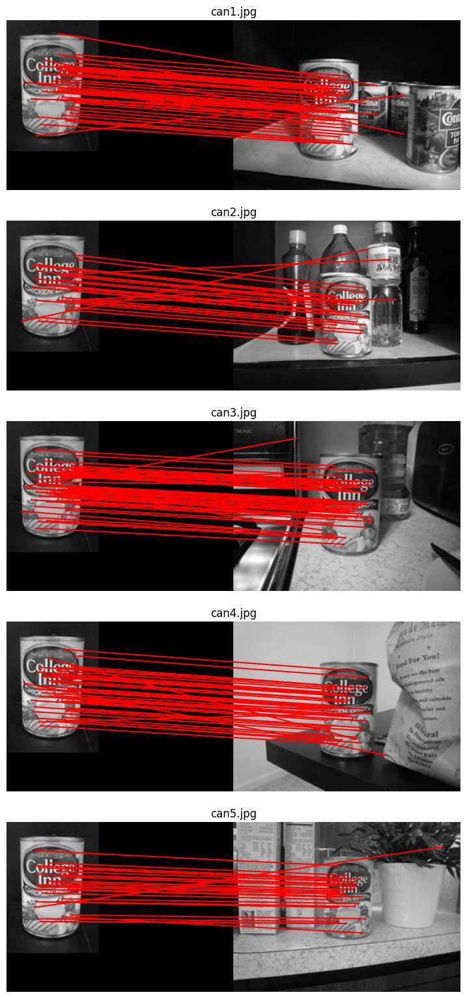

In [6]:
def ratioTest(
    ratioThr: float,
    distances: np.ndarray,
    indices1: np.ndarray,
    indices2: np.ndarray,
) -> np.ndarray:
    """
    Gives mask of indices of points that pass the ratio (distance of best and second best).

    Parameters
    ----------
    ratioThr : float
        Threshold used for ratio test.
    distances : np.ndarray
        Distance matrix.
    indices1 : np.ndarray
        Indices of first image for matching.
    indices2 : np.ndarray
        Indices of second image for matching.

    Returns
    -------
    np.ndarray
        Mask of indices that pass the ratio test.
    """
    distances = distances.copy()
    # Copy best distances
    best_distances = distances[indices1, indices2]
    # Make them inf to use argmin for second best
    distances[indices1, indices2] = np.inf
    second_best_indices2 = np.argmin(distances[indices1], axis=1)
    second_best_distances = distances[indices1, second_best_indices2]
    # Replace zero with eps
    second_best_distances[second_best_distances == 0] = np.finfo(np.float64).eps
    ratio = best_distances / second_best_distances
    mask = ratio < ratioThr
    return mask


def matchBRIEF(
    descriptor1: np.ndarray,
    location1: np.ndarray,
    descriptor2: np.ndarray,
    location2: np.ndarray,
    ratioThr: float,
    crossCheck: bool,
) -> list[list]:
    """
    Matches the most similar descriptors from two different images.

    Additionally filters the descriptors using cross check (optional) and ratio test.

    Parameters
    ----------
    descriptor1 : np.ndarray
        Descriptors from the first image.
    location1 : np.ndarray
        Locations of descriptors from the first image.
    descriptor2 : np.ndarray
        Descriptors from the the second image.
    location2 : np.ndarray
        Locations of descriptors from the second image.
    ratioThr : float
        Ratio test threshold.
    crossCheck : bool
        Cross check boolean.

    Returns
    -------
    list[list]
        List of  most similar pair of features [position in img1, position in img2, distance]

    Raises
    ------
    ValueError
        Raised if first image location and descriptor length dont match.
    ValueError
        Raised if second image location and descriptor length dont match.
    """

    descriptor1 = descriptor1.T
    descriptor2 = descriptor2.T
    location1 = location1.T
    location2 = location2.T
    if len(descriptor1) != len(location1):
        raise ValueError("First image location and descriptor length dont match!")
    if len(descriptor2) != len(location2):
        raise ValueError("Second image location and descriptor length dont match!")
    # Distance matrix using hamming distance
    distances = cdist(
        descriptor1,
        descriptor2,
        metric="hamming",
    )

    indices1 = np.arange(descriptor1.shape[0])

    indices2 = np.argmin(distances, axis=1)

    mask = ratioTest(ratioThr, distances, indices1, indices2)
    indices1 = indices1[mask]
    indices2 = indices2[mask]
    # Matches comparing first with second image
    matches12 = np.column_stack((indices1, indices2))
    if crossCheck:
        # Repeat Ratio test
        indices1 = np.argmin(distances, axis=0)
        indices2 = np.arange(descriptor2.shape[0])
        mask = ratioTest(ratioThr, distances, indices1, indices2)
        indices1 = indices1[mask]
        indices2 = indices2[mask]
        # Matches comparing second with first image
        matches21 = np.column_stack((indices1, indices2))
        matches = np.vstack((matches12, matches21))
        points, count = np.unique(matches, return_counts=True, axis=0)
        # Matches found in both scenarios are saved
        matches = points[count == 2]
    else:
        matches = matches12

    locs1 = location1[matches[:, 0], :2].tolist()
    locs2 = location2[matches[:, 1], :2].tolist()
    dist = distances[matches[:, 0], matches[:, 1]]
    return list(zip(locs1, locs2, dist))


def matchImagesBRIEF(img1: np.ndarray, img2: np.ndarray) -> list[list]:
    """
    Returns matched features in img1 and img2 using BRIEF descriptor.

    Parameters
    ----------
    img1 : np.ndarray
        First image.
    img2 : np.ndarray
        Second image.

    Returns
    -------
    list[list]
        Matched positions in both images and there distance.
    """
    GaussianPyramid1, DoGPyramid1 = createPyramid(img1, sigma0, k, numLevels)
    featureLocations1 = detectDoGFeatures(DoGPyramid1, uniformTh, edgeThr)
    descBRIEF1, locBRIEF1 = computePyrBRIEF(
        GaussianPyramid1, featureLocations1, k, patchSize, p1Coords, p2Coords
    )
    GaussianPyramid2, DoGPyramid2 = createPyramid(img2, sigma0, k, numLevels)
    featureLocations2 = detectDoGFeatures(DoGPyramid2, uniformTh, edgeThr)
    descBRIEF2, locBRIEF2 = computePyrBRIEF(
        GaussianPyramid2, featureLocations2, k, patchSize, p1Coords, p2Coords
    )
    matches = matchBRIEF(
        descBRIEF1, locBRIEF1, descBRIEF2, locBRIEF2, ratioThr, crossCheck=True
    )
    return matches


p1Coords, p2Coords = generateBRIEFpattern(patchSize, testNum)
ratioThr = 0.8
paths = os.listdir("../imgs/can")
fig, axes = plt.subplots(len(paths) - 1, figsize=(9, 20))
fig.subplots_adjust(wspace=0, hspace=0)
imgCan1 = io.imread("../imgs/can/can_model.jpg")
imgCan1 = color.rgb2gray(imgCan1)
for canFile, ax in zip(paths, axes):
    if canFile == "can_model.jpg":
        continue
    ax.set_axis_off()
    ax.set_aspect("equal")
    canPath = os.path.join("../imgs/can", canFile)
    imgCan2 = io.imread(canPath)
    imgCan2 = color.rgb2gray(imgCan2)
    matches = matchImagesBRIEF(imgCan1, imgCan2)
    locs1, locs2, _ = zip(*matches)
    ax.set_title(canFile)
    feature.plot_matches(
        ax,
        imgCan1,
        imgCan2,
        np.array(locs1)[:, [1, 0]],
        np.array(locs2)[:, [1, 0]],
        np.c_[np.arange(len(matches)), np.arange(len(matches))],
        only_matches=True,
        matches_color="red",
    )


## Zadatak 3
Sad je potrebno iskoristiti prethodno napisane funkcije za određivanje obeležja i njihov opis, tako što se primene na dve različite slike i potrebno je upariti najsličnija obležja (metrika je Hammingova distanca) iz obe slike. Pre svega računa se matrica udaljenosti, zatim traži se koja su najbliža obeležaja u drugoj slici u odnosu na obeležja prve slike. Sada se ovaj postupak ponavlja za svako obeležje iz prve slike, samo što se traži koja su obeležja druga najbliža iz druge slike u odnosu na prvu sliku. Ako je odnos najudaljenijeg i drugog najudaljenijeg obeležja manji od 0.8 (najbolja distanca je značajno manja) može se smatrati da su obeležja dobro uparena. Ceo prethodno pomenuti postupak se ponavlja kada prva i druga slika zamene mesta, pa se uzimaju konačno ti parovi obeležja koji su dobijeni u oba slučaja.
<br/>
Za sve prikazane slike u ovom zadatku vidi se da BRIEF opis radi zadovoljavajuće, osim za nekoliko parova tačaka koje su povezane sa pozadinom ili drugim objektom u pozadini. Ovo ne predstavlja veliki problem ako se koriste neke od metoda za odbacivanje outlier-a kao npr. RANSAC algoritam.


In [7]:
def compareAfterTransformation(
    img: np.ndarray,
    parameterSpan: list,
    parameterName: str,
    transformationFunction: Callable,
    matchFunction: Callable,
):
    """
    Compares feature matching using matchFunction on img before and after transformation using transformationFunction.

    Parameters
    ----------
    img : np.ndarray
        Input image
    parameterSpan : list
        Parameter span
    parameterName : str
        Name of parameter
    transformationFunction : Callable
        Transformation function.
    matchFunction : Callable
        Matching function.
    """
    results = {
        parameterName: parameterSpan,
        "good matches": [],
        "number of matches": [],
        "ratio": [],
    }
    for parameter in parameterSpan:
        fig = plt.figure(figsize=(6, 14))
        fig.subplots_adjust(wspace=0, hspace=0)
        ax = plt.gca()
        ax.set_axis_off()
        ax.set_aspect("equal")
        ax.set_title(f"{parameterName}: {parameter}")
        M, transformedImg = transformationFunction(parameter, img)
        matches = matchFunction(img, transformedImg)
        locs1, locs2, _ = zip(*matches)
        locs2GroundTruth = np.c_[locs1, np.ones(len(locs1))] @ M.T
        if locs2GroundTruth.shape[1] == 3:
            locs2GroundTruth = (
                locs2GroundTruth[:, :2] / locs2GroundTruth[:, 2][:, np.newaxis]
            )
        xError, yError = (locs2GroundTruth - locs2).T
        goodMatch = np.hypot(xError, yError) <= 3
        results["good matches"].append(goodMatch.sum())
        results["number of matches"].append(len(goodMatch))
        results["ratio"].append(goodMatch.sum() / len(goodMatch))
        feature.plot_matches(
            ax,
            canModel,
            transformedImg,
            np.array(locs1)[:, [1, 0]],
            np.array(locs2)[:, [1, 0]],
            np.c_[np.arange(len(matches)), np.arange(len(matches))],
            only_matches=True,
            matches_color="red",
        )
    if len(parameterSpan):
        df = pd.DataFrame(results)
        df["ratio"] = df["ratio"].map(lambda x: f"{x:.2%}")
        display(df.style.format_index(str.upper, axis=1).format(precision=2).hide())


## Zadatak 4
U ovom zadatku imamo kontrolisane uslove, gde koristimo sliku modela konzerve i koristimo unapred definisanu matricu transformacije M, i odatle sliku nakon transformacije. Samim tim što imamo i transformaciju, za svako detektovano obeležje, unapred znamo sa kojom tačkom iz transformisane slike treba da se upari. Kao mera koliko je uparena tačka iz transformisane slike blizu pravoj tački, korišćeno je euklidsko rastojanje i smatrano je da je uparivanje uspešno ako ta distanca nije veća od 3. 

ROTATION,GOOD MATCHES,NUMBER OF MATCHES,RATIO
5,46,50,92.00%
10,55,59,93.22%
20,11,15,73.33%
40,0,8,0.00%
80,0,6,0.00%
120,0,9,0.00%


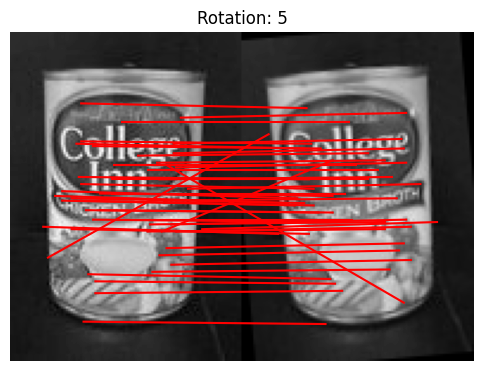

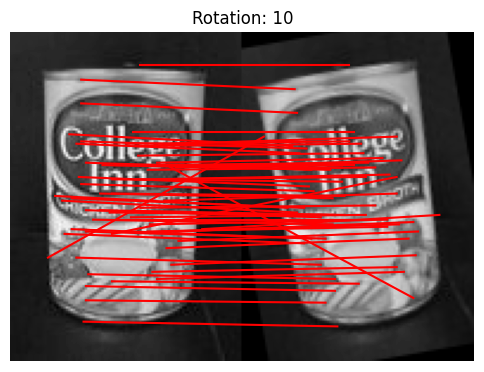

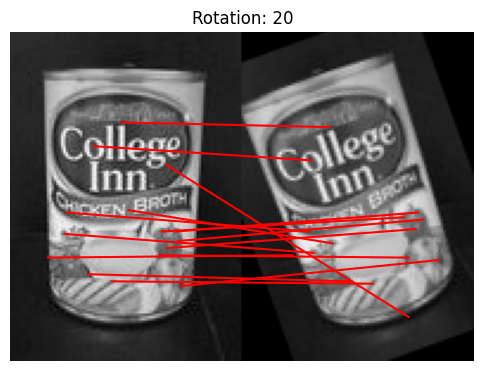

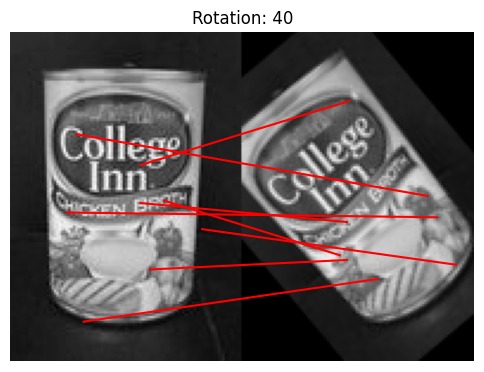

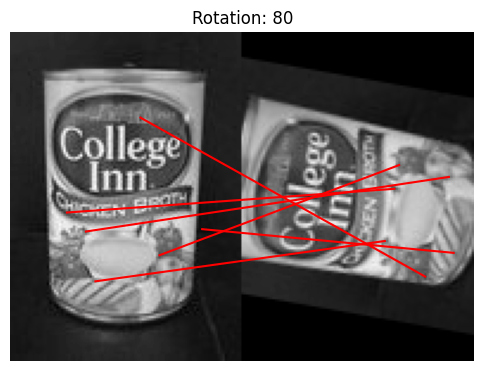

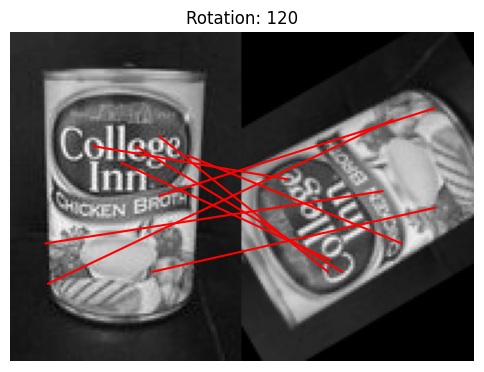

In [8]:
imgCan = io.imread("../imgs/can/can_model.jpg")
imgCan = color.rgb2gray(imgCan)

parameterSpan = [5, 10, 20, 40, 80, 120]
parameterName = "Rotation"


def rotation(angle, img):
    rows, cols = canModel.shape
    M = cv2.getRotationMatrix2D(((cols - 1) / 2.0, (rows - 1) / 2.0), angle, 1)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameterSpan, parameterName, rotation, matchImagesBRIEF
)


### Rotacija
Kada se pomera ugao rotacije slike, očigledno je da sa povećanjem ugla rotacije, broj uparenih tačaka naglo opada, čak i za male vrednosti ugla, a nakon 20 stepeni rotacije, ne postoji nijedan uparen par tačaka. Ovo je direktna posledica korišćenja BRIEF opisa (nije invarijantan na rotaciju).

SCALE,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0.50,18,23,78.26%
2.00,55,59,93.22%
4.00,24,39,61.54%


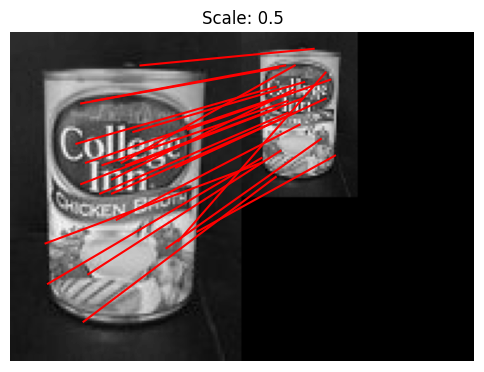

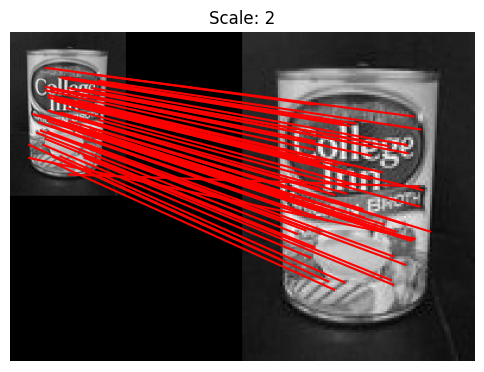

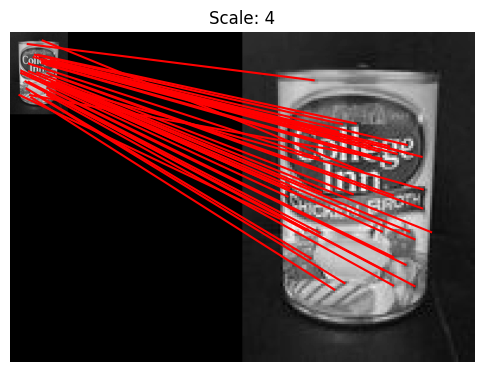

In [9]:
parameterSpan = [0.5, 2, 4]
parameterName = "Scale"


def scale(scale, img):
    M = np.array([[scale, 0, 0], [0, scale, 0]], np.float64)
    return M, cv2.resize(
        img, None, fx=scale, fy=scale, interpolation=cv2.INTER_NEAREST
    )


compareAfterTransformation(
    imgCan, parameterSpan, parameterName, scale, matchImagesBRIEF
)


### Skaliranje
Najbolji rezultati su dobijeni kada je testirana promena skale sa vrednošću 2. Slučajevi kada je skala 0.5 ili 4 daju lošije rezultate, ali ne totalno neupotrebljive. Ovde je problem to što su parametri za generisanje Gausove piramide i DoG piramide ostali nepromenjeni iz prvog zadatka. Kada bismo proširili broj nivoa piramide, rezultati za druge dve skale bili bi značajno bolji.   

SHEER,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0.05,59,62,95.16%
0.10,54,61,88.52%
0.20,34,38,89.47%
0.40,7,12,58.33%


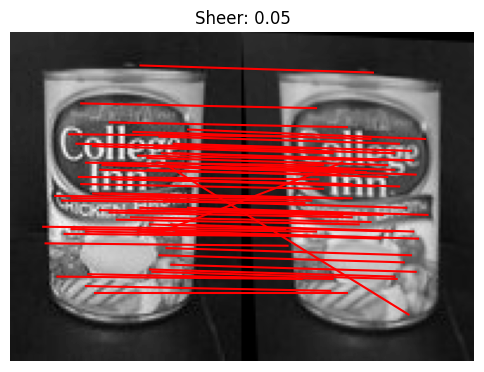

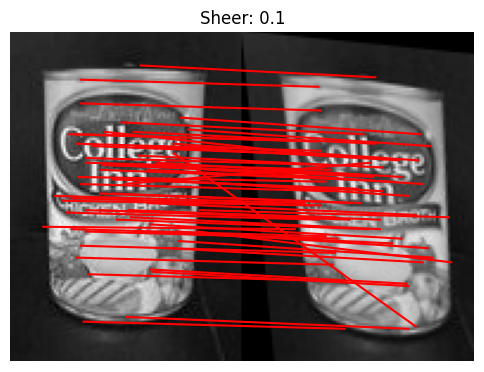

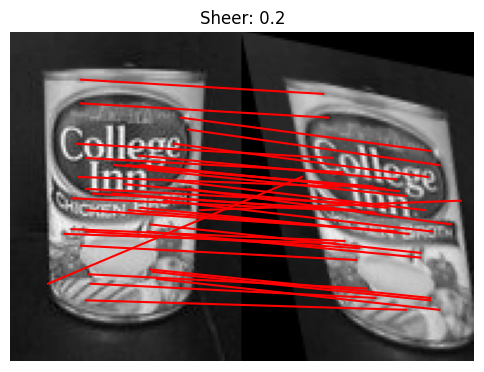

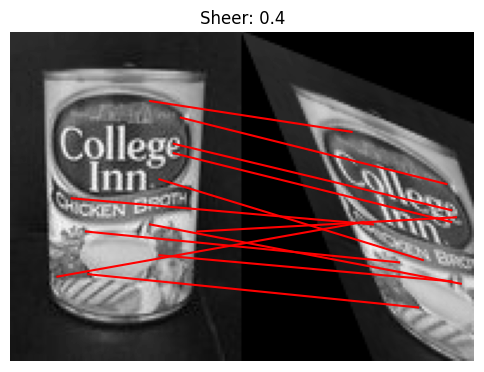

In [10]:
parameterSpan = [0.05, 0.1, 0.2, 0.4]
parameterName = "Sheer"


def sheer(factor, img):
    rows, cols = canModel.shape
    M = np.array([[1, factor, 0], [factor, 1, 0]], np.float64)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameterSpan, parameterName, sheer, matchImagesBRIEF
)


### Smicanje
Za proizvoljnu afinu transformaciju izabrao sam da bude smicanje sa različitim nivoima. U gornjoj tabeli sa rezultatima vidimo da smicanje do vrednosti 0.2 vrlo malo utiče na performanse uparivanja. Sa povećanjem parametra smicanja, dolazi do prevelikog deformiteta slike. 

HOMOGRAPHY,GOOD MATCHES,NUMBER OF MATCHES,RATIO
1,14,17,82.35%


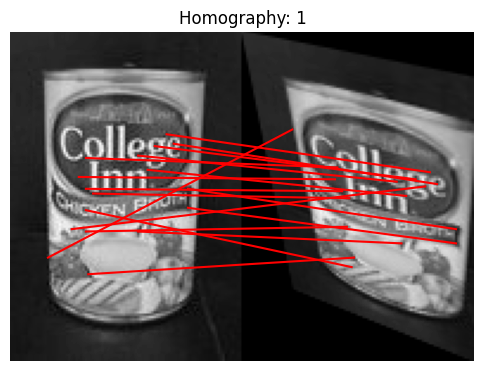

In [11]:
parameterSpan = [1]
parameterName = "Homography"


def homography(parameter, img):
    rows, cols = canModel.shape
    M = np.array([[1, 0.2, 0], [0.2, 1, 0], [-0.002, 0.002, 1]], np.float64)
    return M, cv2.warpPerspective(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameterSpan, parameterName, homography, matchImagesBRIEF
)


### Homografija
Izabrao sam nasumičnu homografiju koja vizuelno ne deformiše previše sliku, i može se zaključiti da u ovakvom slučaju ima malo tačaka, ali dobar deo njih je ispravno uparen.  

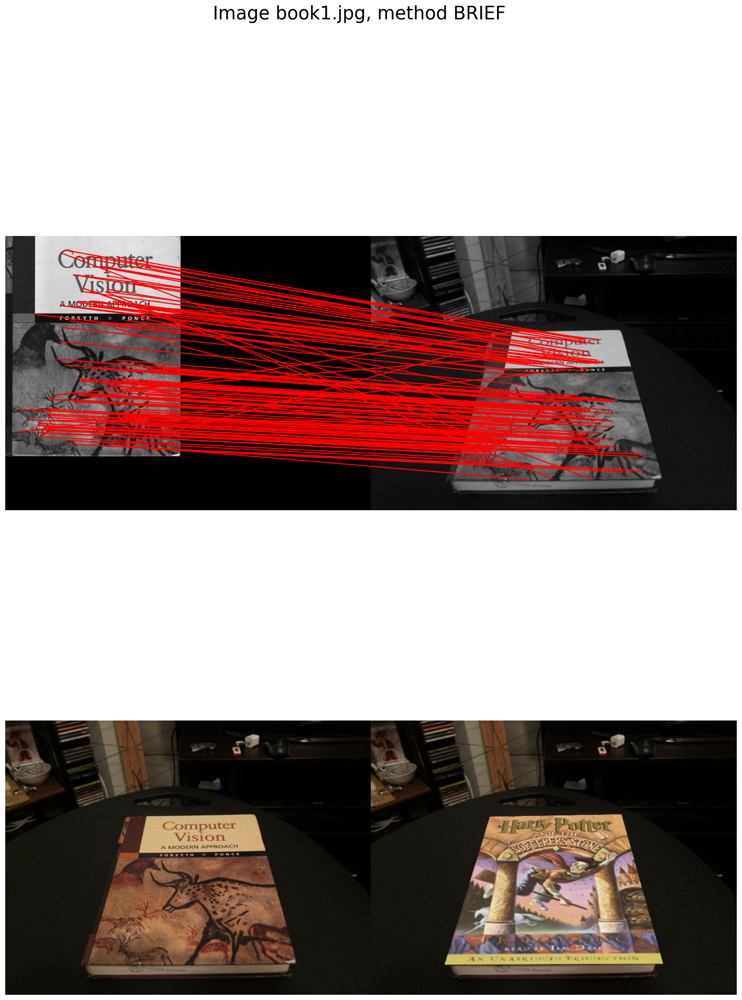

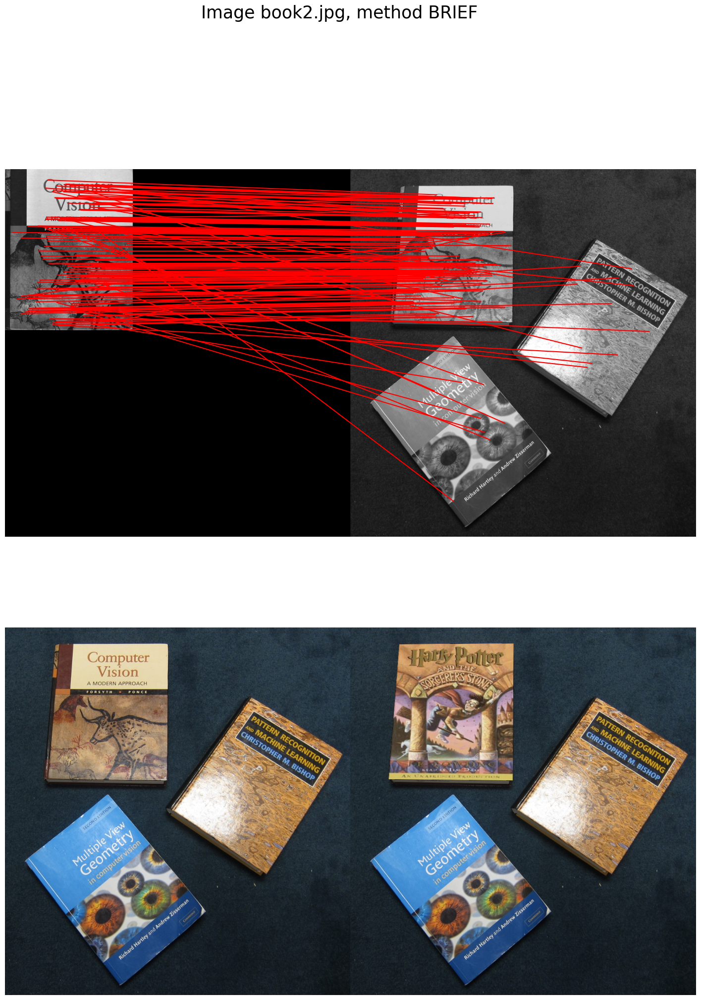

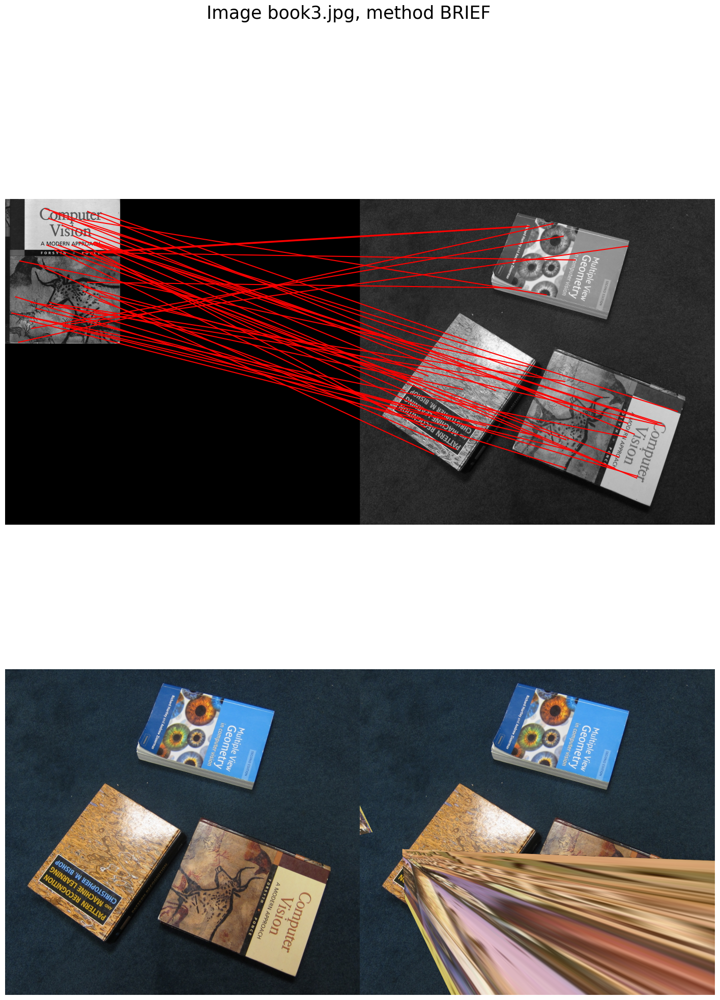

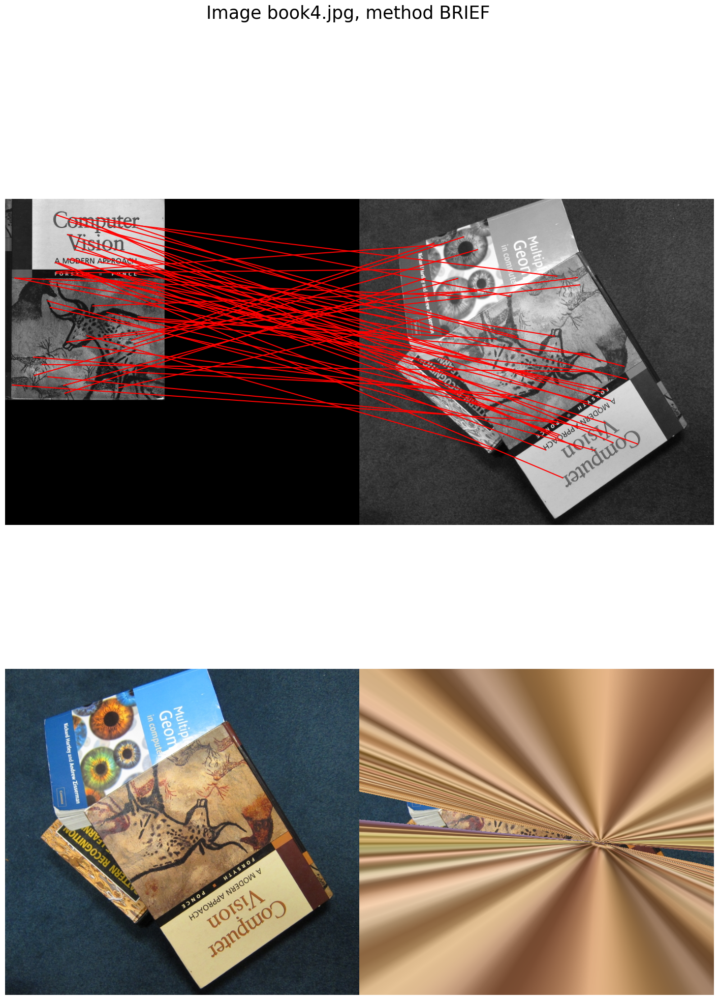

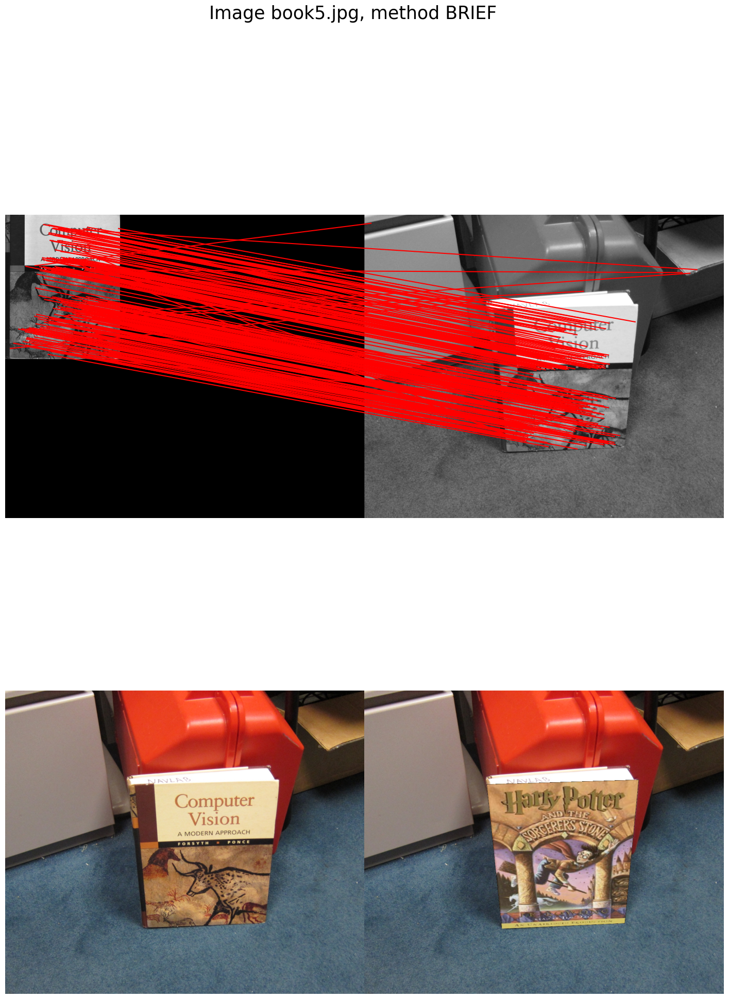

In [12]:
paths = os.listdir("../imgs/book/")
paths = [
    re.fullmatch("book\d\.jpg", p).string
    for p in paths
    if re.fullmatch("book\d\.jpg", p)
]

imgBook1 = cv2.imread("../imgs/book/book_model.jpg", cv2.IMREAD_GRAYSCALE) / 255
imgHP = cv2.imread("../imgs/book/hp_cover.jpg", cv2.IMREAD_COLOR)
imgHP = cv2.cvtColor(imgHP, cv2.COLOR_BGR2RGB)
imgHP = cv2.resize(imgHP, imgBook1.shape[::-1])

for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method BRIEF", size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("../imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE) / 255
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    matches = matchImagesBRIEF(imgBook1, imgBook2)
    locs1, locs2, _ = zip(*matches)
    locs1 = np.array(locs1)
    locs2 = np.array(locs2)
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        np.array(locs1)[:, [1, 0]],
        np.array(locs2)[:, [1, 0]],
        np.c_[np.arange(len(matches)), np.arange(len(matches))],
        only_matches=True,
        matches_color="red",
    )


## Zadatak 5
Sve prethodno napisane funkcije treba iskoristiti sada, kako bi se dobili parovi tačaka, između slike koja sadrži samo knjigu Computer Vision i iste te knjige u prostoru, te je od tih parova tačaka potrebno dobiti proizvoljnu homografiju knjige. Sa dobijenom proizvoljnom homografijom sliku Harry Potter knjige možemo ubaciti na mesto Computer Vision knjige u prostoru. Nakon dobijenih parova tačaka, koristio sam funkciju iz biblioteke OpenCV findHomography za dobijanje matrice homografije sa flag-om za korišćenje RANSAC algoritma. Onda je iskorišćena matrica homografije sa funkcijom warpPerspective za transformisanje Harry Potter knjige u prostoru. 
Na gornjim slikama očigledno je da je transformacija bila neuspešna za slike 3 i 4. Razlog je taj što u tim situacijama tražena knjiga je zarotirana. Ovo smo videli i ranije kada smo testirali na slikama konzerve, i naglašeno je da je ovo mana samog BRIEF opisa. Na ostalim slikama (1, 2 i 5), kada je slika u uspravnom položaju, tranformacija je uspešna.

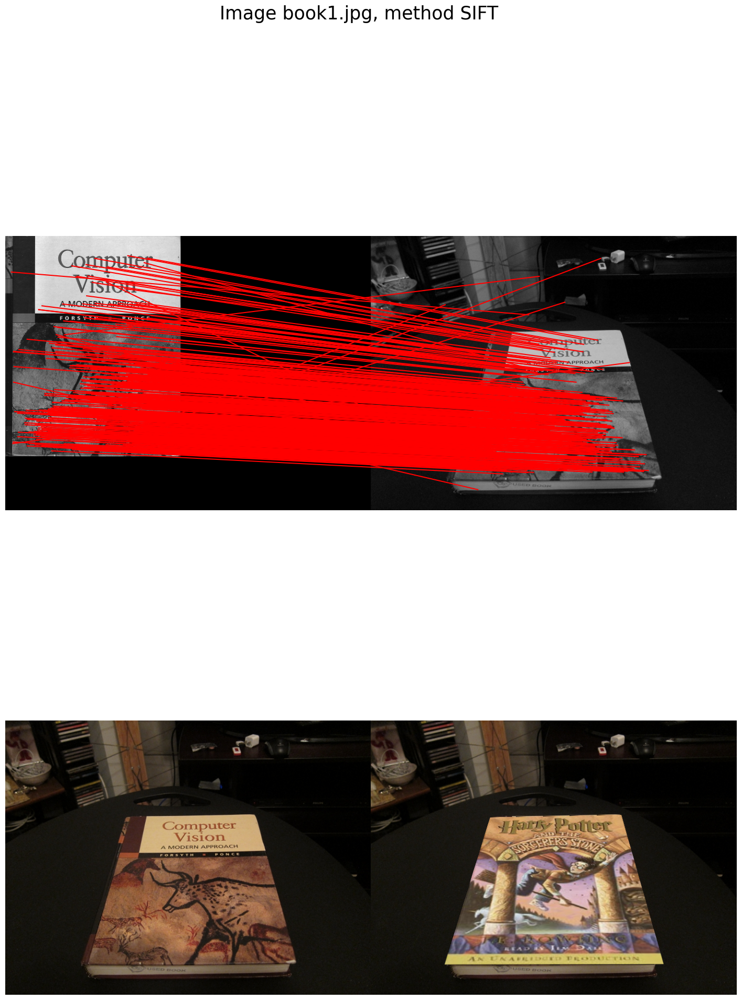

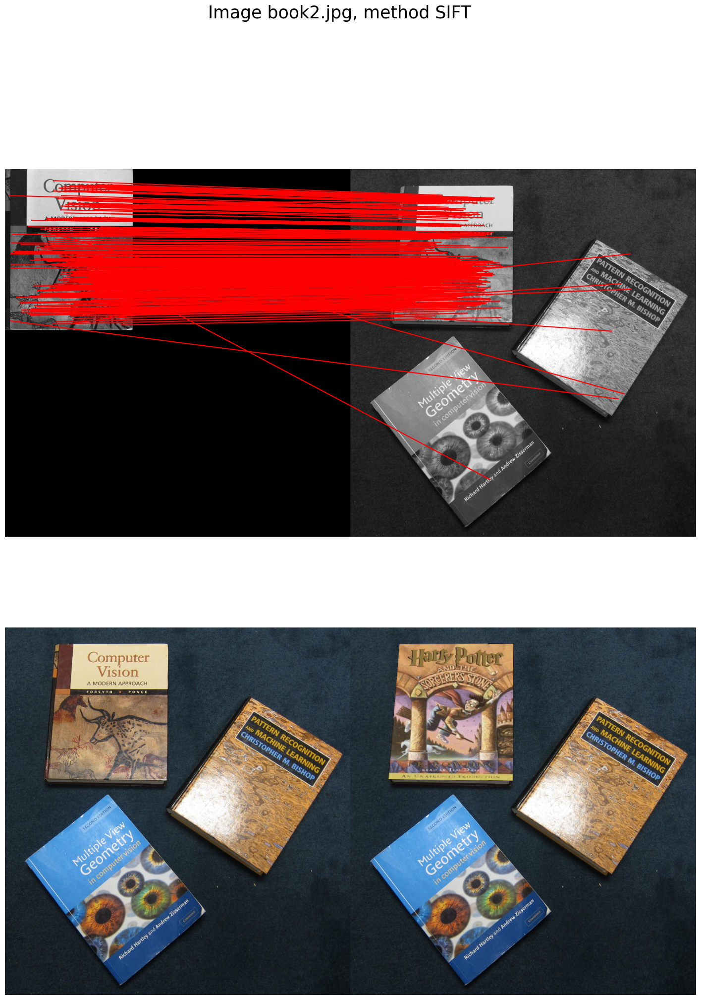

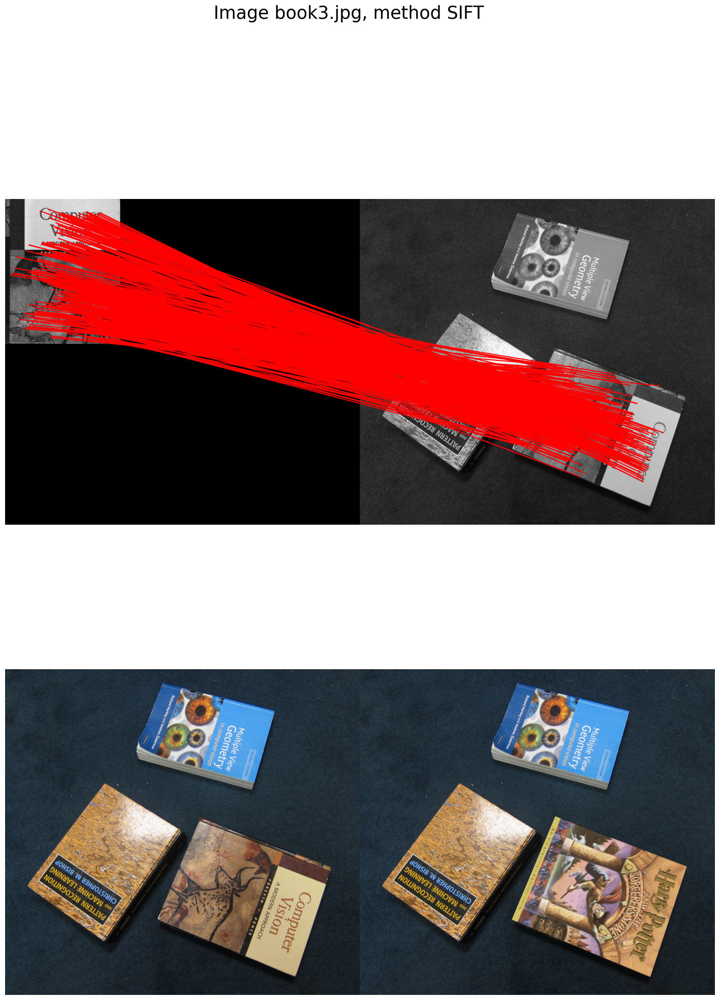

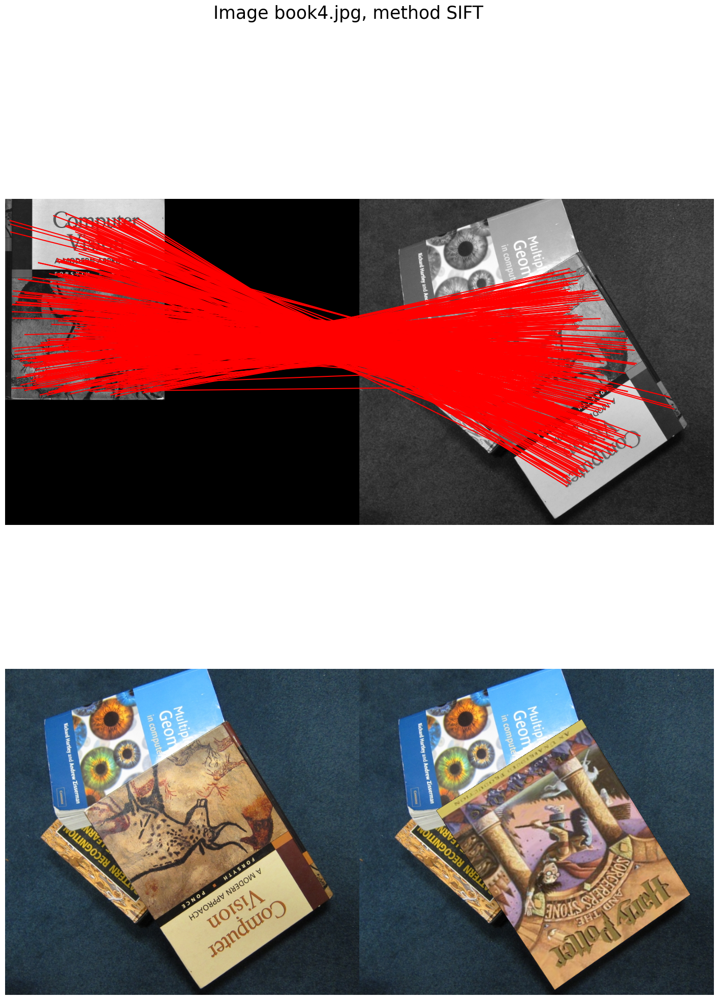

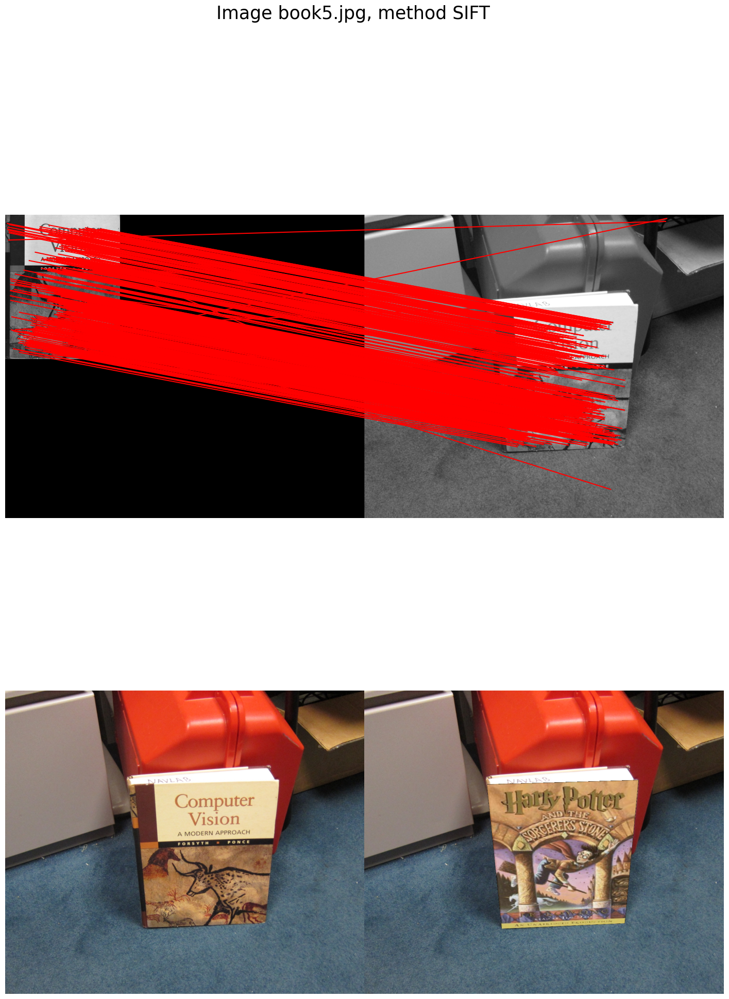

In [13]:
def matchImagesSIFT(img1: np.ndarray, img2: np.ndarray) -> list[list]:
    """
    Returns matched features in img1 and img2 using SIFT descriptor.

    Parameters
    ----------
    img1 : np.ndarray
        First image.
    img2 : np.ndarray
        Second image.

    Returns
    -------
    list[list]
        Matched positions in both images and there distance.
    """
    sift = cv2.SIFT_create()

    # Find the keypoints and descriptors with SIFT
    locSIFTBook1, descSIFT1 = sift.detectAndCompute(img1, None)
    locSIFTBook2, descSIFT2 = sift.detectAndCompute(img2, None)
    locSIFTBook1 = np.array([p.pt for p in locSIFTBook1]).T
    locSIFTBook2 = np.array([p.pt for p in locSIFTBook2]).T
    bf = cv2.BFMatcher(cv2.NORM_L2)
    matches = bf.knnMatch(descSIFT1, descSIFT2, k=2)
    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.8 * n.distance:
            good_matches.append(m)
    matches = np.array([(m.queryIdx, m.trainIdx) for m in good_matches])
    locs1 = locSIFTBook1[:2, matches[:, 0]].T.tolist()
    locs2 = locSIFTBook2[:2, matches[:, 1]].T.tolist()
    return list(zip(locs1, locs2, good_matches))


imgBook1 = cv2.imread("../imgs/book/book_model.jpg", cv2.IMREAD_GRAYSCALE)
for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method SIFT", size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("../imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE)
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    matches = matchImagesSIFT(imgBook1, imgBook2)
    locs1, locs2, _ = zip(*matches)
    locs1 = np.array(locs1)
    locs2 = np.array(locs2)
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        np.array(locs1)[:, [1, 0]],
        np.array(locs2)[:, [1, 0]],
        np.c_[np.arange(len(matches)), np.arange(len(matches))],
        only_matches=True,
        matches_color="red",
    )


Ceo zadatak je ponovljen, samo što je korišćen SIFT kao detektor i deskriptor. Na slikama parova tačaka može se primetiti da je značajno povećan broj parova u odnosu na prvi način implementacije. Pored toga, rotiranje slike u prostoru uopšte ne predstavlja problem za detekciju obeležja. Razlog ovome je taj što je SIFT napravljen da bude invarijantan na rotaciju.  

In [14]:
def detectDoGFeatures2(DoGPyramid: list, uniformTh: float, edgeThr: float) -> list:
    """
    Detects key feature points in DoGPyramid.

    Improved on detectDoGFeatures, the local dominate orientation is saved along side x, y and scale.

    Parameters
    ----------
    DoGPyramid : list
        List of different levels of DoG.
    uniformTh : float
        Threshold for uniform background points.
    edgeThr : float
        Threshold for Hessian based edge points.

    Returns
    -------
    list
        List of features (x, y, scale).
    """
    DoGPyramid = np.array(DoGPyramid)
    # Local maximum peaks
    localPeaks = (
        maximum_filter(DoGPyramid, footprint=np.ones((3, 3, 3)), mode="nearest")
        == DoGPyramid
    )
    notUniform = np.abs(DoGPyramid) > uniformTh
    candidates = np.logical_and(localPeaks, notUniform)
    featureLocations = []
    for scale, y, x in zip(*np.nonzero(candidates)):
        if (
            x < 2
            or x > DoGPyramid.shape[2] - 3
            or y < 2
            or y > DoGPyramid.shape[1] - 3
        ):
            continue
        localNeighborhood = DoGPyramid[scale, y - 2 : y + 3, x - 2 : x + 3]
        # First derivative
        Dx = (localNeighborhood[1:-1, 2:] - localNeighborhood[1:-1, :-2]) / 2
        Dy = (localNeighborhood[2:, 1:-1] - localNeighborhood[:-2, 1:-1]) / 2
        # Second derivative
        Dxx = (Dx[1, 2] - Dx[1, 0]) / 2
        Dyx = (Dx[2, 1] - Dx[0, 1]) / 2
        Dyy = (Dy[2, 1] - Dy[0, 1]) / 2
        Dxy = (Dy[1, 2] - Dy[1, 0]) / 2
        detH = Dxx * Dyy - Dxy * Dyx
        traceH = Dxx + Dyy
        ratio = traceH * traceH / detH
        if ratio < edgeThr:
            # Gradient magnitude
            G = Dx**2 + Dy**2
            # Index of largest gradient
            Gy, Gx = np.unravel_index(np.argmax(G), G.shape)
            # Gradient angle of largest gradient
            theta = np.arctan2(Dy[Gy, Gx], Dx[Gy, Gx])
            featureLocations.append((x, y, scale, theta))
    return featureLocations


def computePyrBRIEF2(
    GaussianPyramid: np.ndarray,
    featureLocations: list,
    k: float,
    patchSize: int,
    p1Coords: np.ndarray,
    p2Coords: np.ndarray,
) -> tuple[np.ndarray, np.ndarray]:
    """
    Computes descriptions of featureLocations that are not outside of image boundary.

    Improved on computePyrBRIEF, the local dominate orientation is used before indexing BRIEF pattern.

    Parameters
    ----------
    GaussianPyramid : np.ndarray
        Gaussian pyramid.
    featureLocations : list
        Position of located key features.
    k : float
        Multiplicative increase in scale for next pyramid level.
    patchSize : int
        Local Region used for p1Coords and p2Coords.
    p1Coords : np.ndarray
        First point in BRIEF pair.
    p2Coords : np.ndarray
        Second point in BRIEF pair.

    Returns
    -------
    tuple[np.ndarray,np.ndarray]
        Description of key feature and there respective location.

    Raises
    ------
    ValueError
        If p1Coords and p2Coords length dont match.
    """

    if len(p1Coords) != len(p2Coords):
        raise ValueError("Coordinates length dont match!")
    descBRIEF = []
    locBRIEF = []
    imgHeight, imgWidth = GaussianPyramid[0].shape
    for x, y, scale, theta in featureLocations:
        # Rescaled patchSize
        regionSize = patchSize * k**scale
        borderWidth = regionSize // 2
        # Take into consideration the rotation angle
        borderWidth += (
            np.abs((np.sin(theta) * np.sqrt(2) / 2 * borderWidth)).astype(np.intp)
            + 1
        )
        # Outside of image boundary for x,y
        if (
            x < borderWidth
            or x > imgWidth - (borderWidth + 1)
            or y < borderWidth
            or y > imgHeight - (borderWidth + 1)
        ):
            continue
        # Rotation matrix
        R = np.r_[
            [[np.cos(theta), -np.sin(theta)]], [[np.sin(theta), np.cos(theta)]]
        ]
        p1RelativeCords = (
            np.round(p1Coords @ R.T / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        p2RelativeCords = (
            np.round(p2Coords @ R.T / patchSize * regionSize).astype(np.intp)
            + np.c_[x, y]
        ).T
        img = GaussianPyramid[scale]

        p1 = img[p1RelativeCords[1], p1RelativeCords[0]]
        p2 = img[p2RelativeCords[1], p2RelativeCords[0]]
        # rBRIEF descriptor
        descBRIEF.append(p1 > p2)
        locBRIEF.append((x, y, scale))
    descBRIEF = np.array(descBRIEF).T
    locBRIEF = np.array(locBRIEF).T
    return descBRIEF, locBRIEF


def matchImagesrBRIEF(img1: np.ndarray, img2: np.ndarray) -> list[list]:
    """
    Returns matched features in img1 and img2 using BRIEF descriptor.

    Improved on matchImagesBRIEF, the local dominate orientation is used.

    Parameters
    ----------
    img1 : np.ndarray
        First image.
    img2 : np.ndarray
        Second image.

    Returns
    -------
    list[list]
        Matched positions in both images and there distance.
    """
    GaussianPyramid1, DoGPyramid1 = createPyramid(img1, sigma0, k, numLevels)
    featureLocations1 = detectDoGFeatures2(DoGPyramid1, uniformTh, edgeThr)
    descBRIEF1, locBRIEF1 = computePyrBRIEF2(
        GaussianPyramid1, featureLocations1, k, patchSize, p1Coords, p2Coords
    )
    GaussianPyramid2, DoGPyramid2 = createPyramid(img2, sigma0, k, numLevels)
    featureLocations2 = detectDoGFeatures2(DoGPyramid2, uniformTh, edgeThr)
    descBRIEF2, locBRIEF2 = computePyrBRIEF2(
        GaussianPyramid2, featureLocations2, k, patchSize, p1Coords, p2Coords
    )
    matches = matchBRIEF(
        descBRIEF1, locBRIEF1, descBRIEF2, locBRIEF2, ratioThr, crossCheck=True
    )
    return matches


Zaključeno je da je rotacija najveći problem, zato kao modifikacija originalne implementacije u trenutku detekcije obeležja, pored pozicije i skale obeležja, čuva se i informacija o dominantnoj rotaciji lokalnog regiona. Ovo se računa pomoću ugla gradijenta sa najvećom magnitudom u lokalnom regionu obeležja. Ova informacija o rotaciji dalje se koristi neposredno pre računanja BRIEF opisa, tako što se od ugla napravi matrica rotacije i iskoristi za pomeranje prvih i drugih od parova brief tačaka (testova).

ROTATION,GOOD MATCHES,NUMBER OF MATCHES,RATIO
0,123,123,100.00%
5,24,31,77.42%
10,32,40,80.00%
20,29,38,76.32%
40,21,26,80.77%
80,32,38,84.21%
120,15,24,62.50%
180,123,123,100.00%


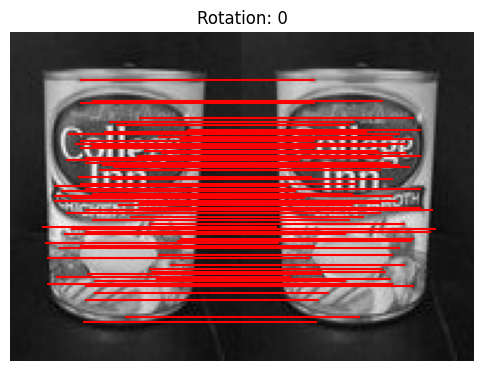

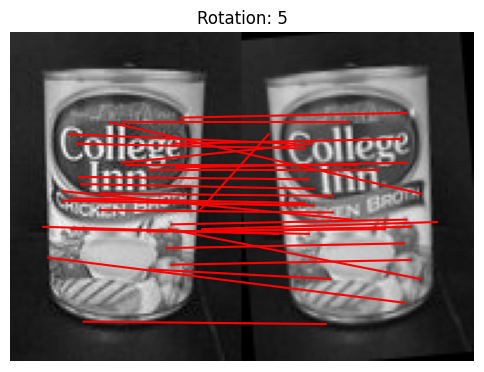

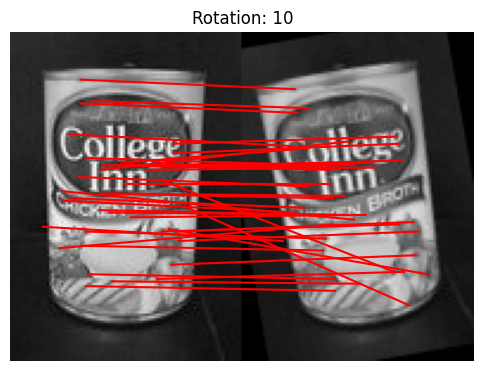

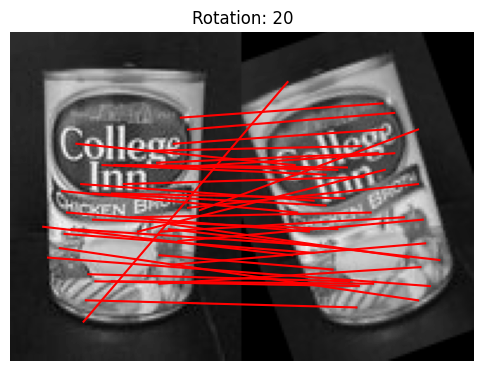

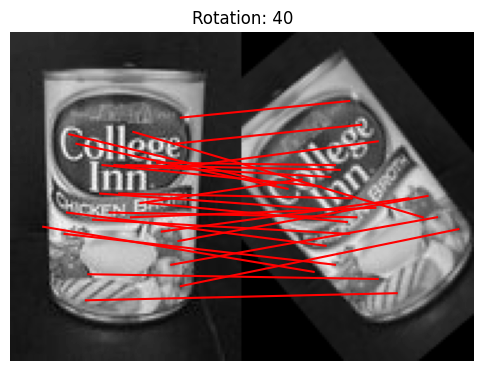

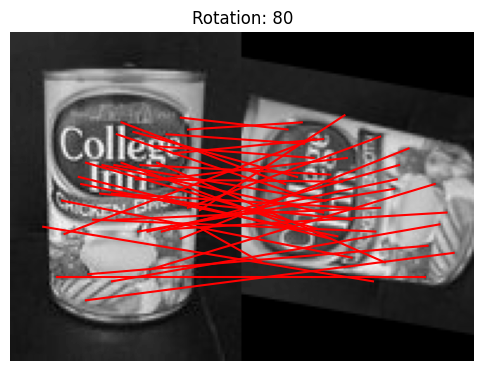

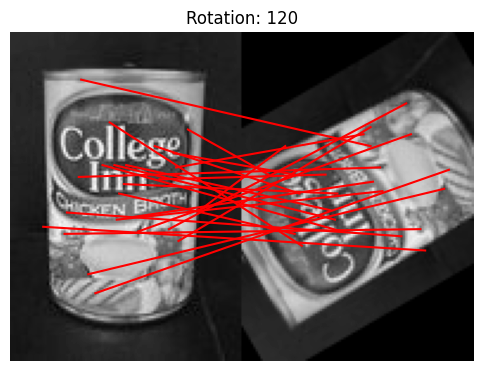

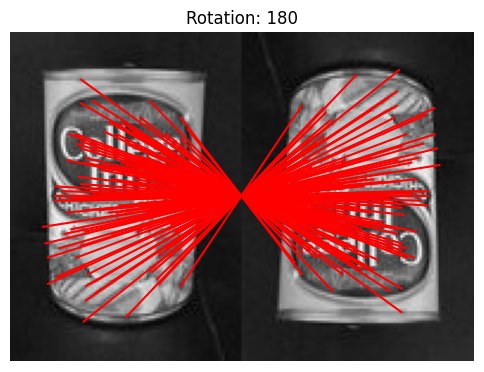

In [15]:
imgCan = io.imread("../imgs/can/can_model.jpg")
imgCan = color.rgb2gray(imgCan)
parameterSpan = [0, 5, 10, 20, 40, 80, 120, 180]
parameterName = "Rotation"


def rotation(angle, img):
    rows, cols = canModel.shape
    M = cv2.getRotationMatrix2D(((cols - 1) / 2.0, (rows - 1) / 2.0), angle, 1)
    return M, cv2.warpAffine(img, M, (cols, rows))


compareAfterTransformation(
    imgCan, parameterSpan, parameterName, rotation, matchImagesrBRIEF
)


Kada se ponovi test sa rotiranjem konzerve, može se videti da dodatne modifikacije BRIEF algoritmu značajno povećavaju invarijantnost na rotaciju. 

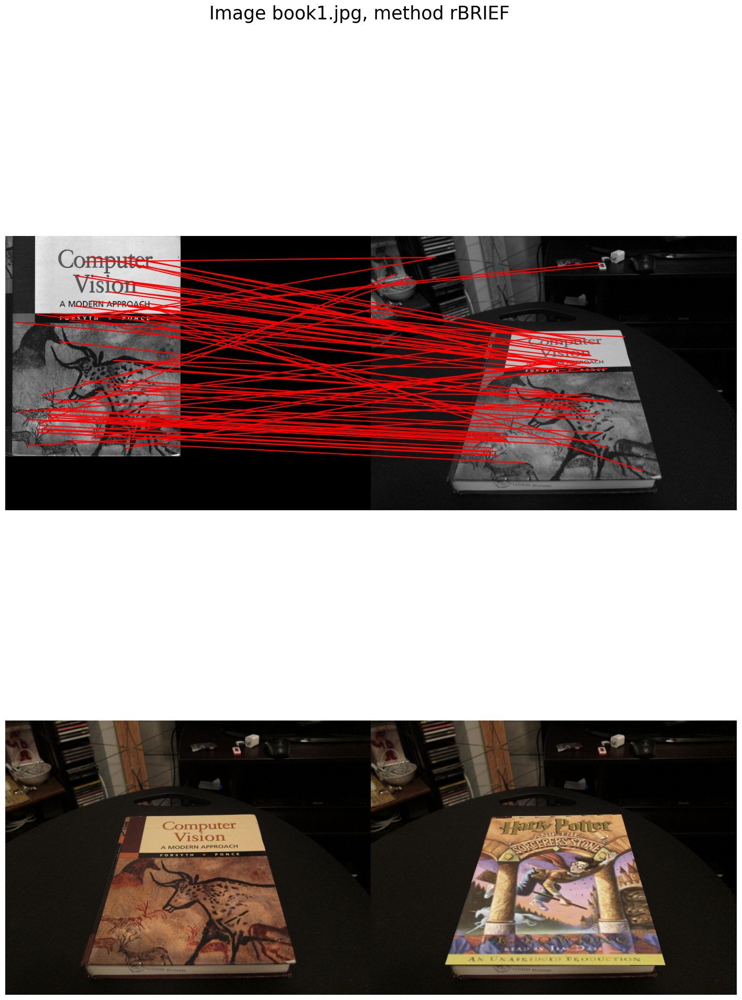

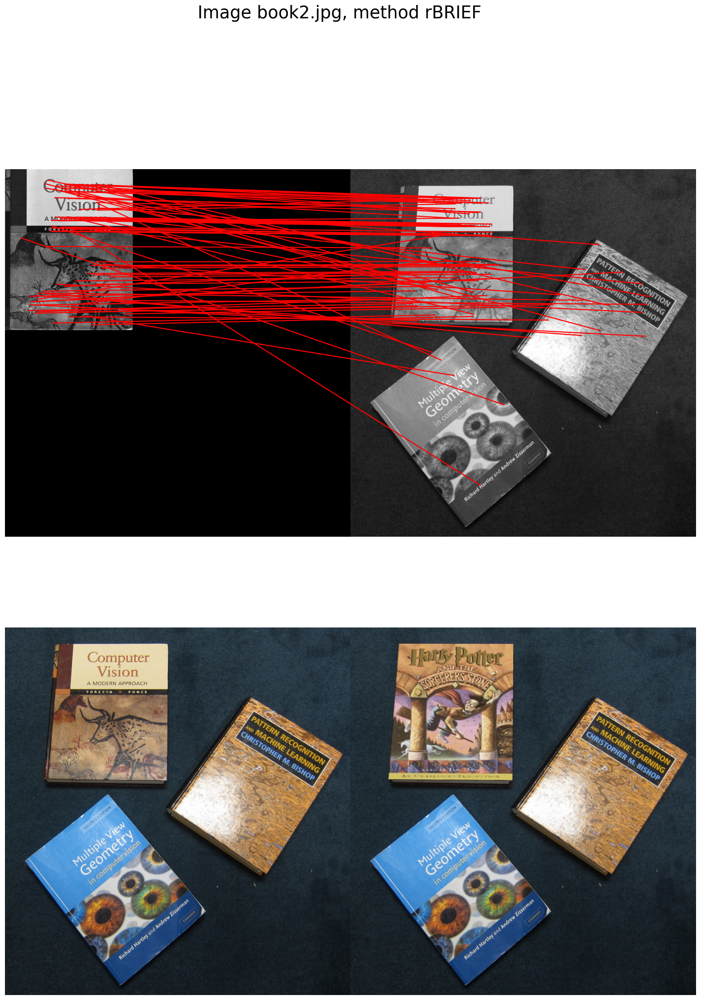

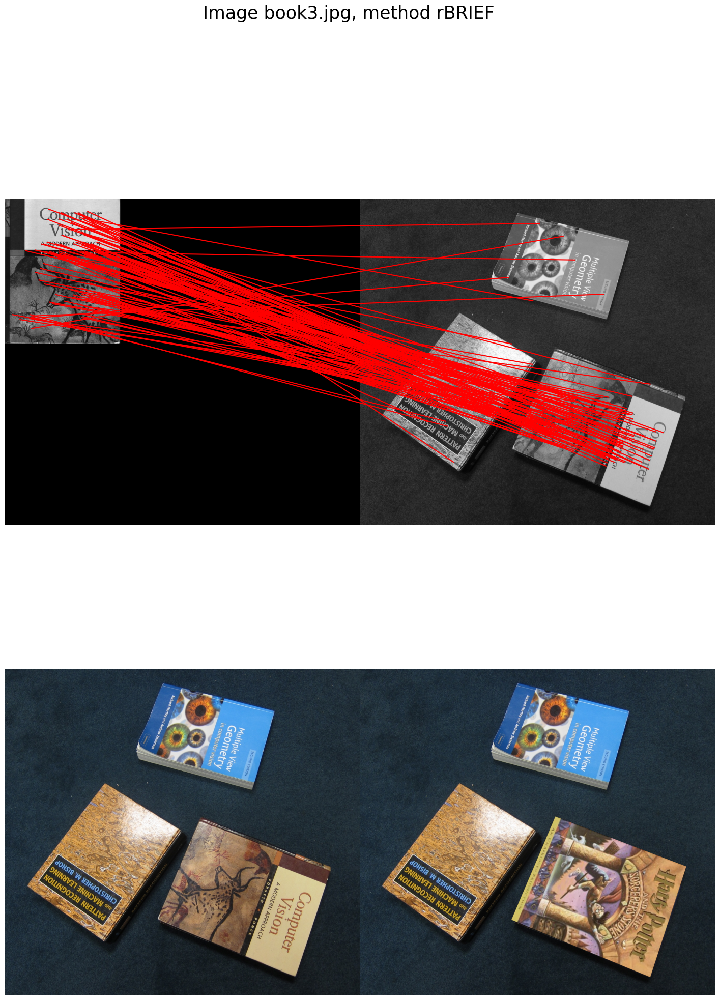

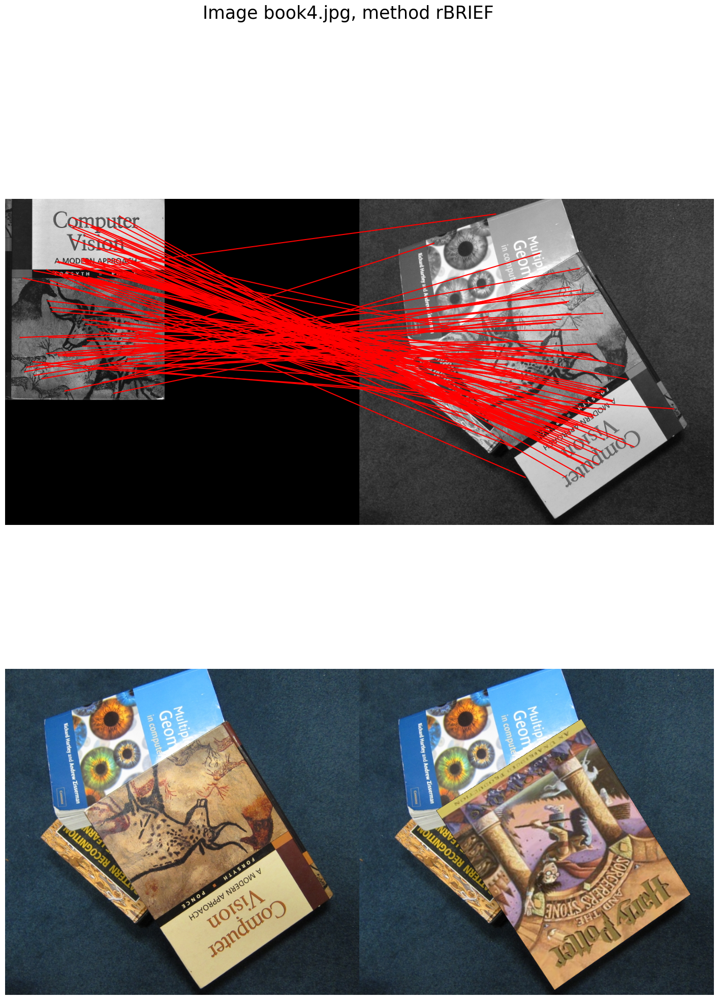

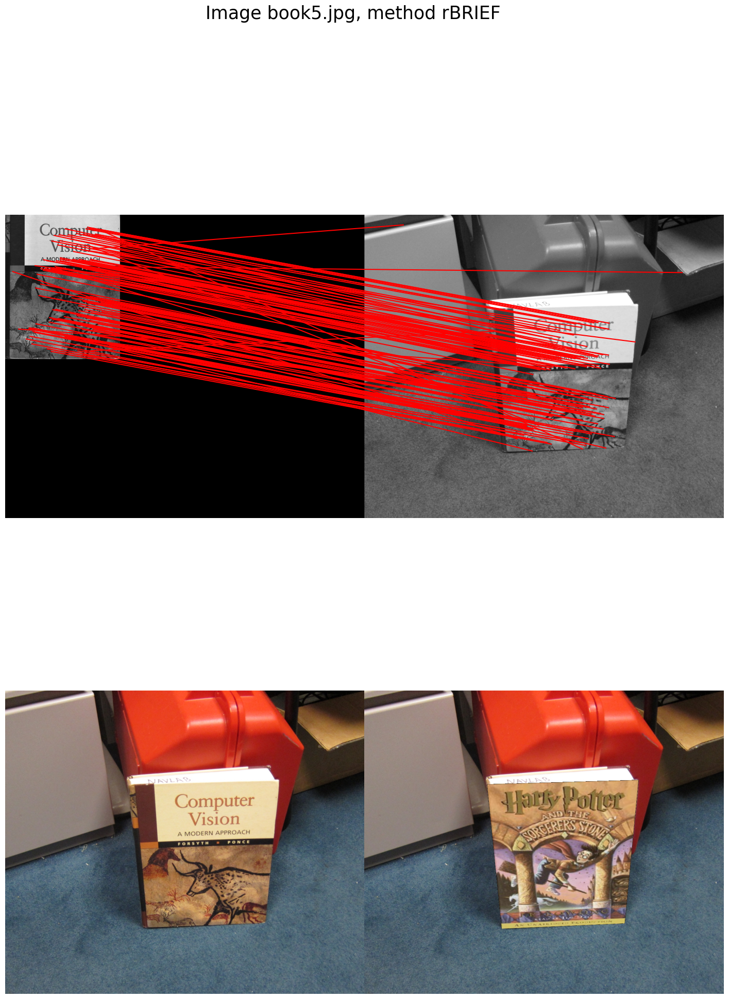

In [16]:
imgBook1 = cv2.imread("../imgs/book/book_model.jpg", cv2.IMREAD_GRAYSCALE) / 255
for bookFile in paths:
    fig = plt.figure(figsize=(18, 24))

    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, :])
    ax2 = fig.add_subplot(gs[1, 0])
    ax3 = fig.add_subplot(gs[1, 1])
    fig.suptitle(f"Image {bookFile}, method rBRIEF", size=25)
    fig.subplots_adjust(wspace=0, hspace=0)
    ax1.set_axis_off()
    ax1.set_aspect("equal")
    ax2.set_axis_off()
    ax2.set_aspect("equal")
    ax3.set_axis_off()
    ax3.set_aspect("equal")
    bookPath = os.path.join("../imgs/book", bookFile)
    imgBook2 = cv2.imread(bookPath, cv2.IMREAD_GRAYSCALE) / 255
    imgBook2Color = cv2.imread(bookPath, cv2.IMREAD_COLOR)
    imgBook2Color = cv2.cvtColor(imgBook2Color, cv2.COLOR_BGR2RGB)
    rows, cols = imgBook2.shape
    matches = matchImagesrBRIEF(imgBook1, imgBook2)
    locs1, locs2, _ = zip(*matches)
    locs1 = np.array(locs1)
    locs2 = np.array(locs2)
    M, _ = cv2.findHomography(locs1, locs2, cv2.RANSAC)

    transformedBook = cv2.warpPerspective(imgHP, M, (cols, rows))
    mask = transformedBook != 0
    newImg = imgBook2Color * np.logical_not(mask) + transformedBook * mask
    ax2.imshow(imgBook2Color, cmap="gray", interpolation=None)
    ax3.imshow(newImg, cmap="gray", interpolation=None)
    feature.plot_matches(
        ax1,
        imgBook1,
        imgBook2,
        np.array(locs1)[:, [1, 0]],
        np.array(locs2)[:, [1, 0]],
        np.c_[np.arange(len(matches)), np.arange(len(matches))],
        only_matches=True,
        matches_color="red",
    )


Kada se ponovi ceo zadatak, evidentno je da je prethodna situacija skroz popravljena, pri čemu prethodni dobri slučajevi nisu pokvareni. 